In [1]:
%load_ext autoreload

import os, sys
sys.path.insert(0, "../")

%autoreload 2
from flowset import *

import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 300

In [2]:
def download_and_unzip(download_url_link, dir_path, zipped_filename,destination_dir_name):
    #https://www.tutorialsbuddy.com/download-and-unzip-a-zipped-file-in-python
    print("Download starting")
    urllib.request.urlretrieve(
        download_url_link, os.path.join(dir_path, zipped_filename)
    )
    print("Download complete")

    print("unzipping file starting")
    with zipfile.ZipFile(os.path.join(dir_path, zipped_filename), "r") as zip_file:
        zip_file.extractall(os.path.join(dir_path, destination_dir_name))
    print("unzipping complete")


if not os.path.exists("ReactomePathways.gmt"):
    download_and_unzip("https://reactome.org/download/current/ReactomePathways.gmt.zip", ".", "ReactomePathways.gmt.zip", ".")

In [4]:
exprData = pl.read_csv("./summarised_simulated_scdata_Chu_random.tsv", has_header=True, sep="\t", null_values=["NA"])
print(exprData)

shape: (62354, 13)
┌──────┬────────────┬───────────┬────────────┬─────┬────────────┬────────┬────────────┬────────────┐
│ clus ┆ count_expr ┆ min.clust ┆ lower_hing ┆ ... ┆ count_all. ┆ gene   ┆ not_expr.c ┆ expr.clust │
│ ter  ┆ .cluster   ┆ er        ┆ e.cluster  ┆     ┆ cluster    ┆ ---    ┆ luster     ┆ er         │
│ ---  ┆ ---        ┆ ---       ┆ ---        ┆     ┆ ---        ┆ str    ┆ ---        ┆ ---        │
│ str  ┆ i64        ┆ f64       ┆ f64        ┆     ┆ i64        ┆        ┆ f64        ┆ f64        │
╞══════╪════════════╪═══════════╪════════════╪═════╪════════════╪════════╪════════════╪════════════╡
│ clus ┆ 33         ┆ 0.006106  ┆ 0.013079   ┆ ... ┆ 92         ┆ A1BG   ┆ 0.641304   ┆ 0.358696   │
│ ter. ┆            ┆           ┆            ┆     ┆            ┆        ┆            ┆            │
│ time ┆            ┆           ┆            ┆     ┆            ┆        ┆            ┆            │
│ poin ┆            ┆           ┆            ┆     ┆            ┆       

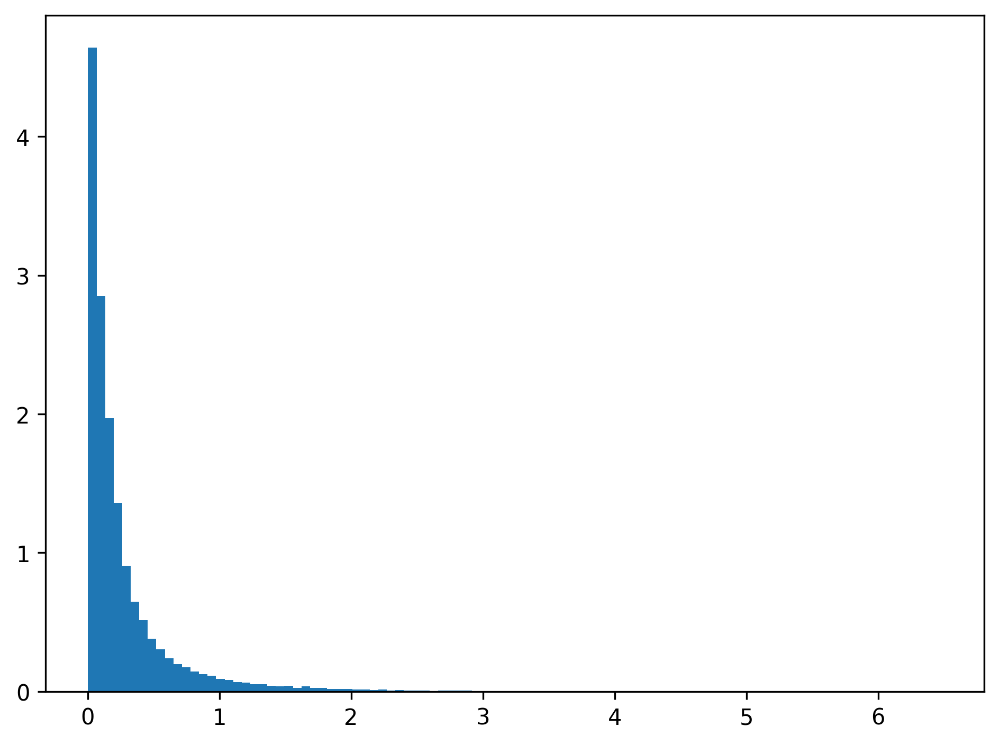

In [5]:
def pl_hist(df, column, n_bins=100,):
    data = df.select(pl.col(column))
    
    fig, ax = plt.subplots(1, 1, tight_layout=True)
    ax.hist(data, bins=n_bins, density=True)
    
    plt.show()
    plt.close()
pl_hist(exprData, "mean.cluster")

Creating Range [[0.]] -> [[8.]]
Mean Expr mean.cluster col 7
Expr Count expr.cluster col 12
SD sd.cluster col 8
cluster.timepoint01
cluster.timepoint02
cluster.timepoint03
cluster.timepoint04



gene,HIGH.cluster.timepoint01,LOW.cluster.timepoint01,LOWMED.cluster.timepoint01,MED.cluster.timepoint01,MEDHIGH.cluster.timepoint01,NO.cluster.timepoint01,NOLOW.cluster.timepoint01,HIGH.cluster.timepoint02,LOW.cluster.timepoint02,LOWMED.cluster.timepoint02,MED.cluster.timepoint02,MEDHIGH.cluster.timepoint02,NO.cluster.timepoint02,NOLOW.cluster.timepoint02,HIGH.cluster.timepoint03,LOW.cluster.timepoint03,LOWMED.cluster.timepoint03,MED.cluster.timepoint03,MEDHIGH.cluster.timepoint03,NO.cluster.timepoint03,NOLOW.cluster.timepoint03,HIGH.cluster.timepoint04,LOW.cluster.timepoint04,LOWMED.cluster.timepoint04,MED.cluster.timepoint04,MEDHIGH.cluster.timepoint04,NO.cluster.timepoint04,NOLOW.cluster.timepoint04
str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""A1BG""",0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
"""A1CF""",0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
"""A2ML1""",0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
"""AAAS""",0.0,0.065656,0.009873,6.2756e-18,0.0,0.720217,0.204254,0.0,0.061838,0.000568,0.0,0.0,0.701808,0.235786,0.0,0.034948,0.012579,0.0,0.0,0.777166,0.175308,0.0,0.036006,0.000823,0.0,0.0,0.736416,0.226754
"""AACS""",0.0,0.006694,0.0,0.0,0.0,0.905764,0.087543,0.0,0.0,0.0,0.0,0.0,0.957196,0.042804,0.0,0.007238,9.5030e-19,0.0,0.0,0.949098,0.043665,0.0,0.011936,0.0,0.0,0.0,0.882242,0.105822
"""AADAT""",0.0,0.0,0.0,0.0,0.0,0.967832,0.032168,0.0,0.003584,0.0,0.0,0.0,0.940934,0.055482,0.0,0.0,0.0,0.0,0.0,0.996651,0.003349,0.0,0.0,0.0,0.0,0.0,0.936674,0.063326
"""AAED1""",0.0,0.0,0.0,0.0,0.0,1.0,8.2413e-19,0.0,0.0,0.0,0.0,0.0,0.998503,0.001497,0.0,0.0,0.0,0.0,0.0,1.0,5.1140e-19,0.0,0.0,0.0,0.0,0.0,1.0,0.0
"""AAGAB""",0.0,0.016297,2.5062e-18,0.0,0.0,0.89003,0.093673,0.0,0.0,0.0,0.0,0.0,0.970773,0.029227,0.0,0.0,0.0,0.0,0.0,0.94003,0.05997,0.0,0.002305,0.0,0.0,0.0,0.883974,0.113721
"""AAK1""",0.0,0.158362,0.015306,0.005137,0.0,0.456402,0.364793,0.0,0.226345,0.039099,0.004881,0.0,0.40102,0.328655,0.0,0.178018,0.018881,0.004502,0.0,0.496488,0.302111,0.0,0.197202,0.042761,0.009636,0.0,0.388688,0.361713


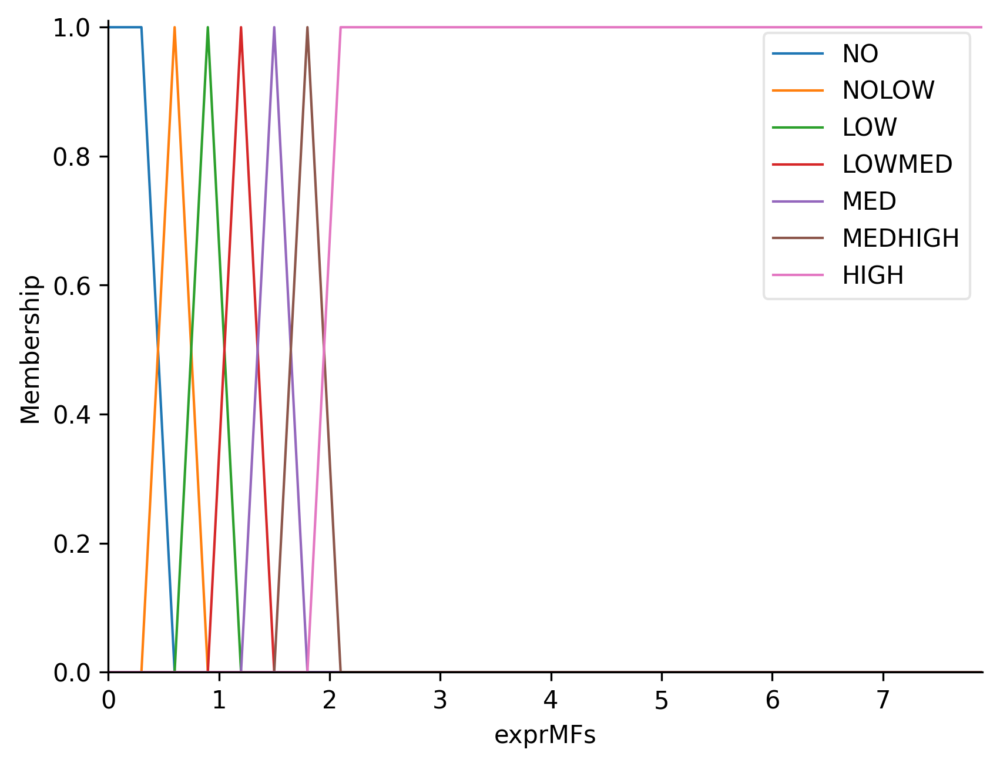

In [7]:


explDFRaw, mfFuzzy = FlowAnalysis.exprDF2LongDF(exprData, stepsize=0.1,seriesOrder=["cluster.timepoint01", "cluster.timepoint02", "cluster.timepoint03", "cluster.timepoint04"],mfLevels = ["NO","NOLOW","LOW","LOWMED","MED","MEDHIGH","HIGH"],centers=[.3,.6,.9,1.2,1.5,1.8,2.1])
#explDFRaw, mfFuzzy = FlowAnalysis.exprDF2LongDF(exprData, stepsize=0.1,seriesOrder=["cluster.timepoint01", "cluster.timepoint02"],mfLevels = ["NO","HIGH"],centers=[1,1.5])
print()
explDFWide = FlowAnalysis.to_vwide(explDFRaw, mfFuzzy)
explDFWide

In [8]:
fa = FlowAnalysis(explDFWide, "gene", (  ("timepoint01","TP1"),  ("timepoint02","TP2"),  ("timepoint03","TP3"),  ("timepoint04","TP4")), mfFuzzy) 
#print(fa.flowid2flow)



Creating FlowIDs


Figure Size (16, 16)


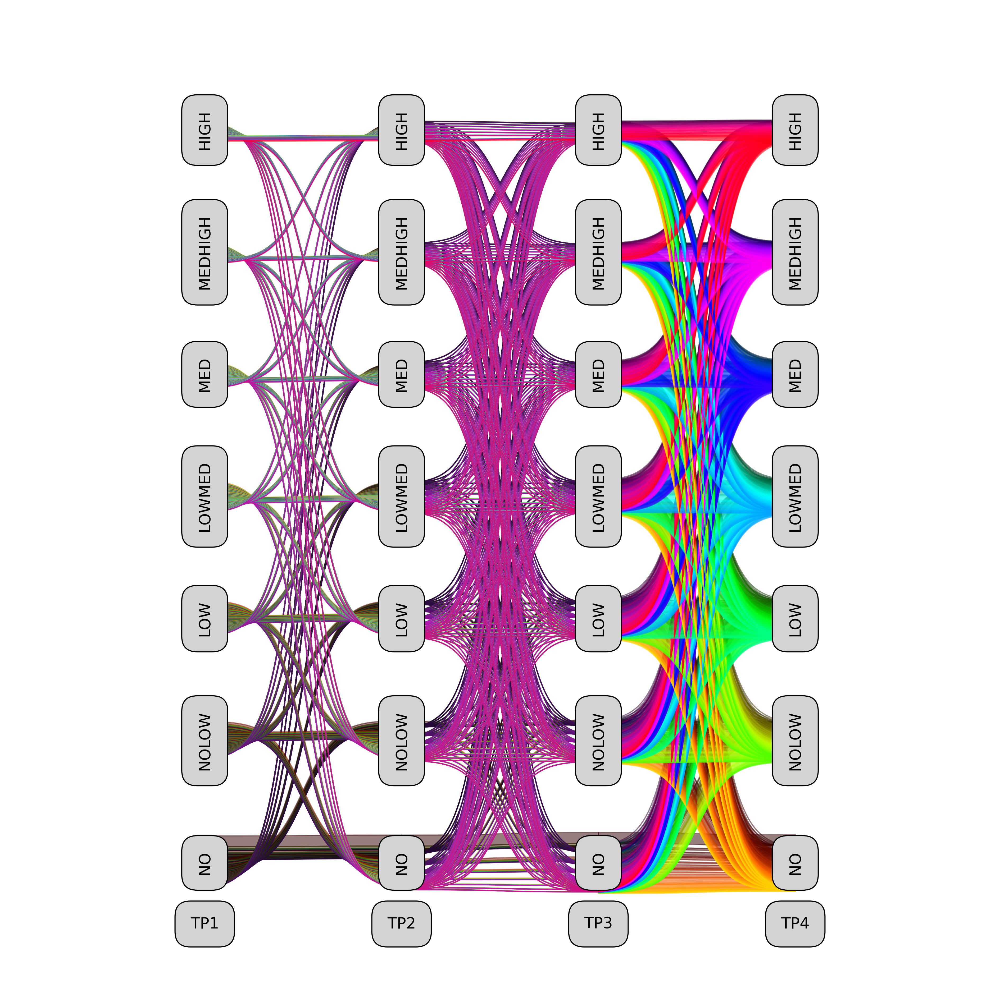

In [9]:
fa.plot_flows()


In [10]:
#pwScores = fa.analyse_pathways()
#pwScores[pwScores.adj_pval < 0.001].sort_values("adj_pval")

rp = fa.read_gmt_file("ReactomePathways.gmt")


In [11]:
alteredPathways=pd.read_csv('simulated_changingPathways_Chu_random.tsv',sep='\t')

pattern_groups=dict()
for pattern in alteredPathways[alteredPathways.duplicated() == False].iterrows():
    strpattern = '-'.join(pattern[-1].astype(str))
    pattern_groups[strpattern]=alteredPathways[[x[-1].equals(pattern[-1]) for x in alteredPathways.iterrows()]].index

pattern_groups

{'1.0-1.0-4.0-4.0': Index(['Glyoxylate metabolism and glycine degradation',
        'G beta:gamma signalling through BTK',
        'Thrombin signalling through proteinase activated receptors (PARs)',
        'Defective SLC12A3 causes Gitelman syndrome (GS)',
        'Chaperonin-mediated protein folding', 'RHOBTB2 GTPase cycle',
        'Diseases of mitotic cell cycle',
        'Ras activation upon Ca2+ influx through NMDA receptor',
        'Trafficking of GluR2-containing AMPA receptors',
        'NRAGE signals death through JNK'],
       dtype='object'),
 '1.0-8.0-8.0-1.0': Index(['Defects in cobalamin (B12) metabolism', 'Olfactory Signaling Pathway',
        'CREB1 phosphorylation through NMDA receptor-mediated activation of RAS signaling',
        'MPS VII - Sly syndrome', 'RSK activation', 'AURKA Activation by TPX2',
        'FRS-mediated FGFR1 signaling', 'Transport of fatty acids',
        'Transcription of E2F targets under negative control by p107 (RBL1) and p130 (RBL2) in com

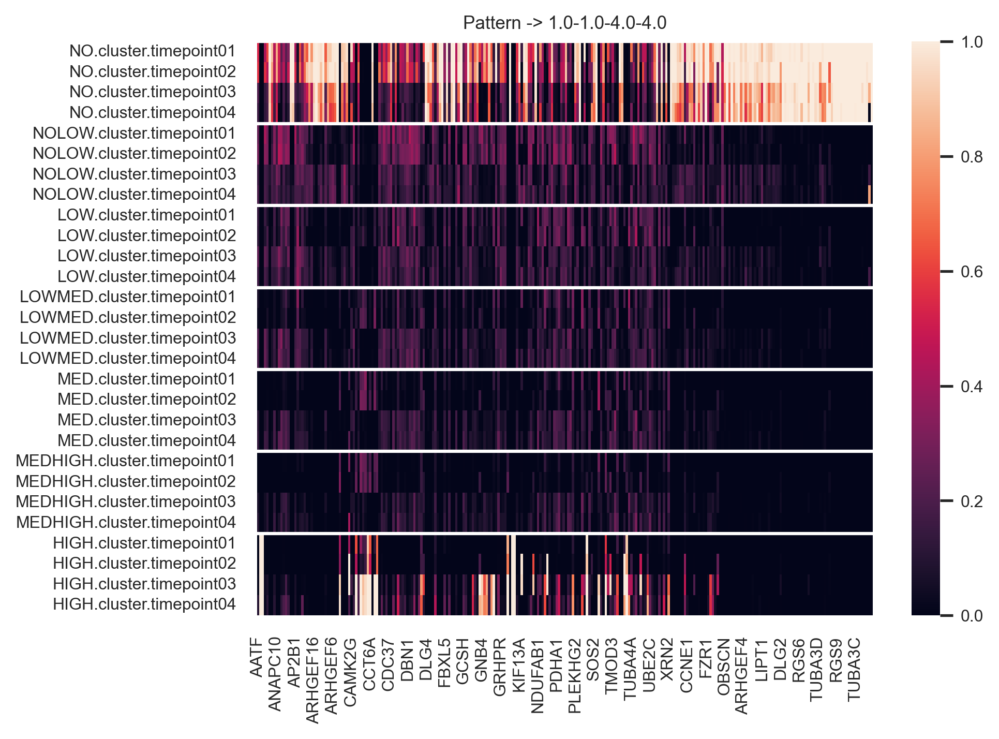

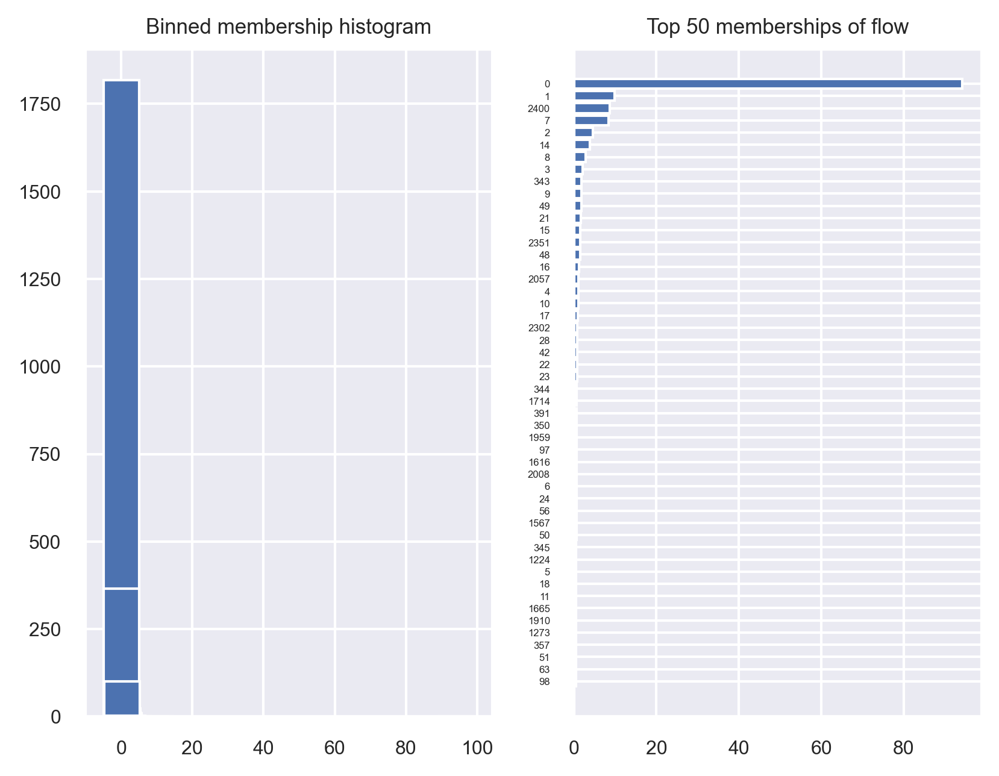

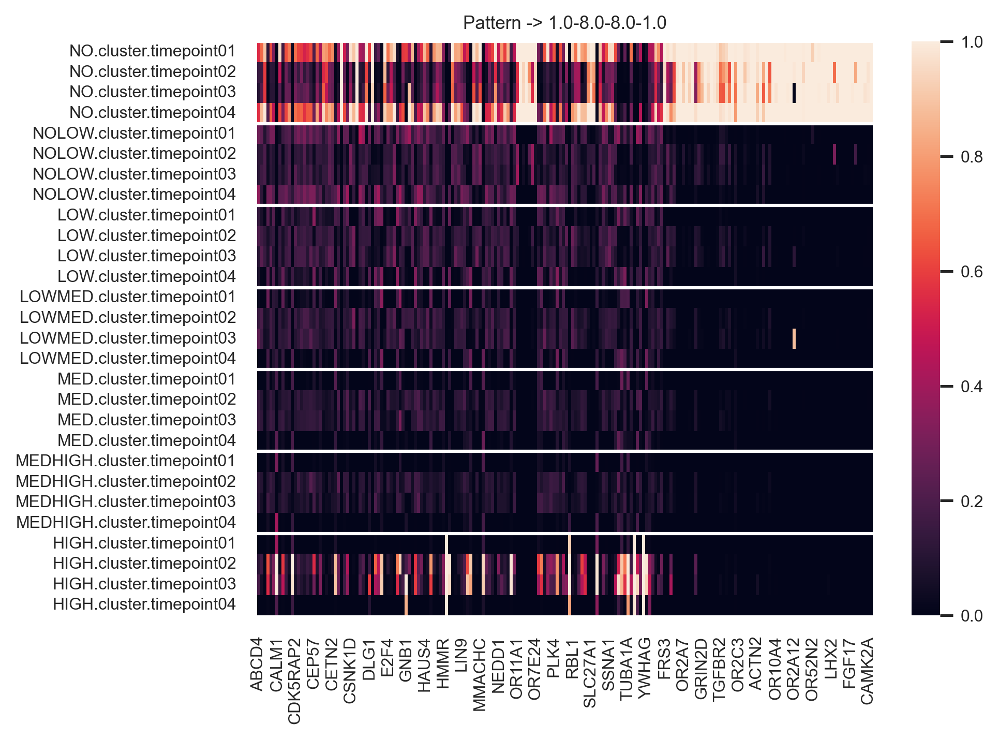

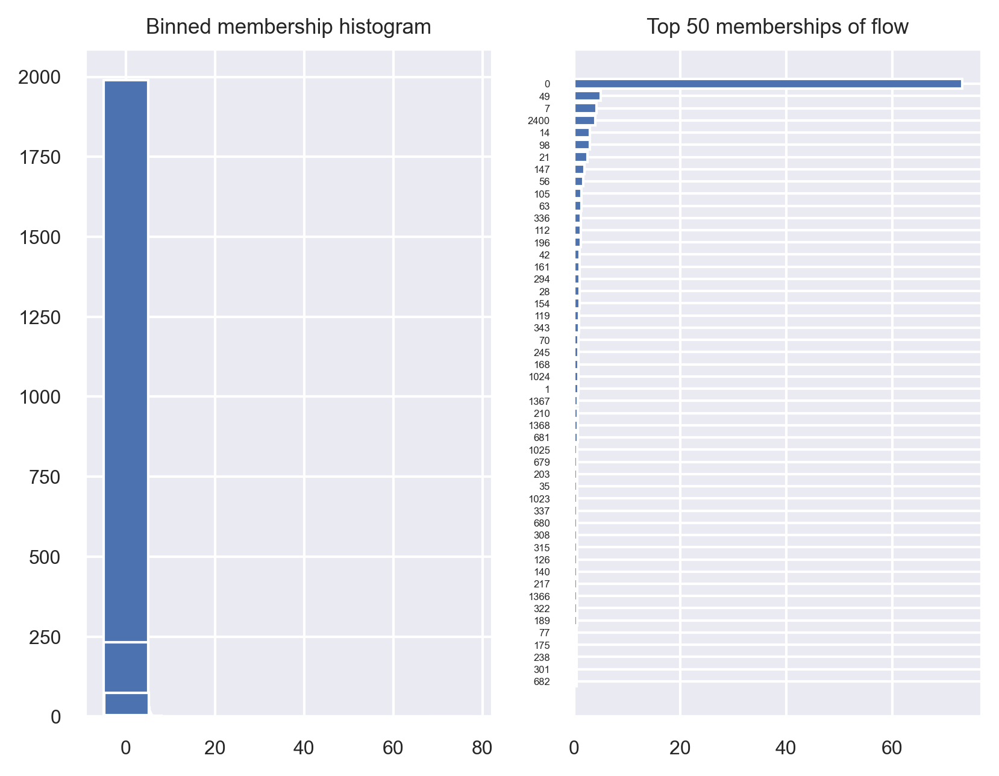

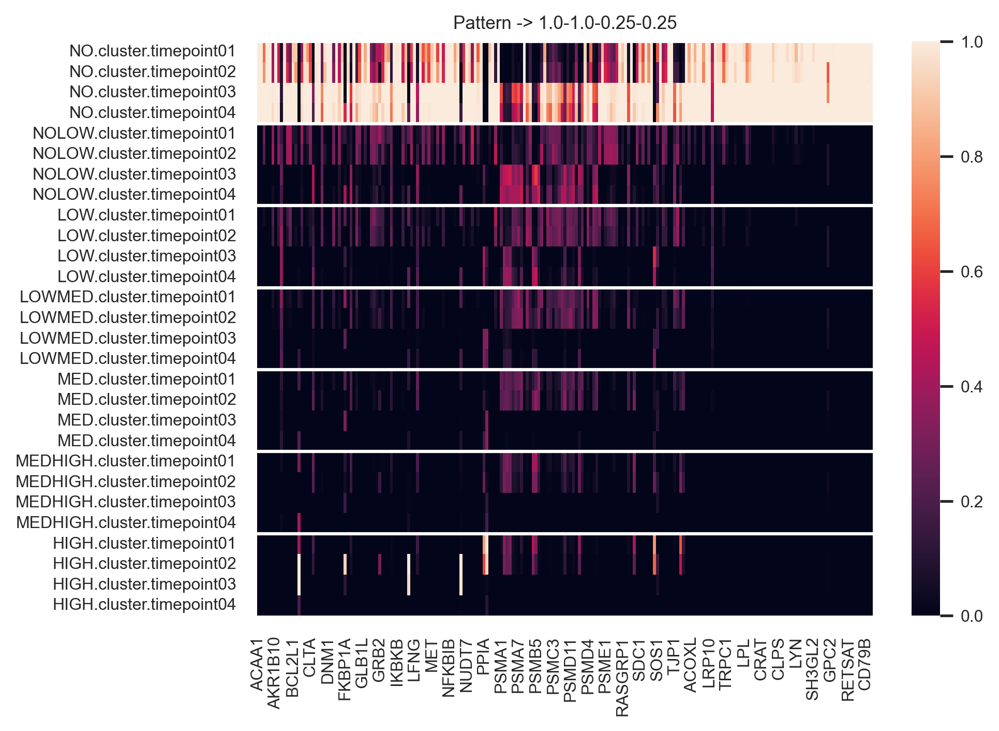

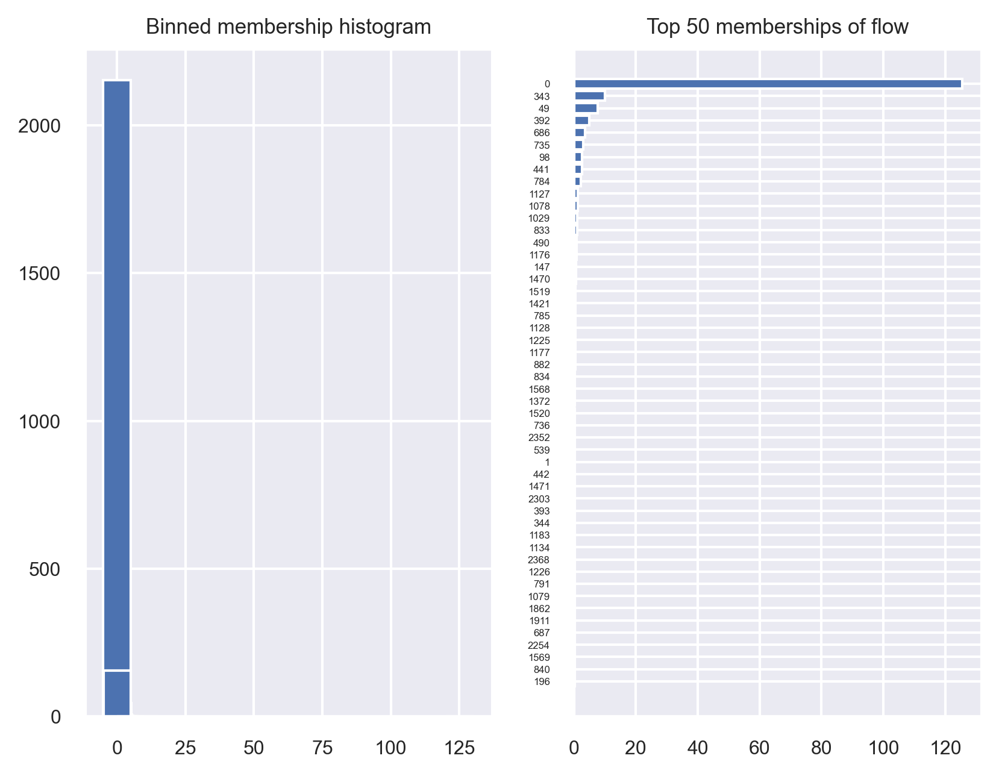

In [12]:

pwnames=[rp[x][0] for x in rp]

for key, value in pattern_groups.items():
    union_geneset=[rp[list(rp.keys())[pwnames.index(p)]][1] for p in value]
    union_geneset = [item for sublist in union_geneset for item in sublist]
    fa.plot_state_memberships(union_geneset,"Pattern -> "+key)
    fa.plot_genes_membership(union_geneset)



Figure Size (16, 16)


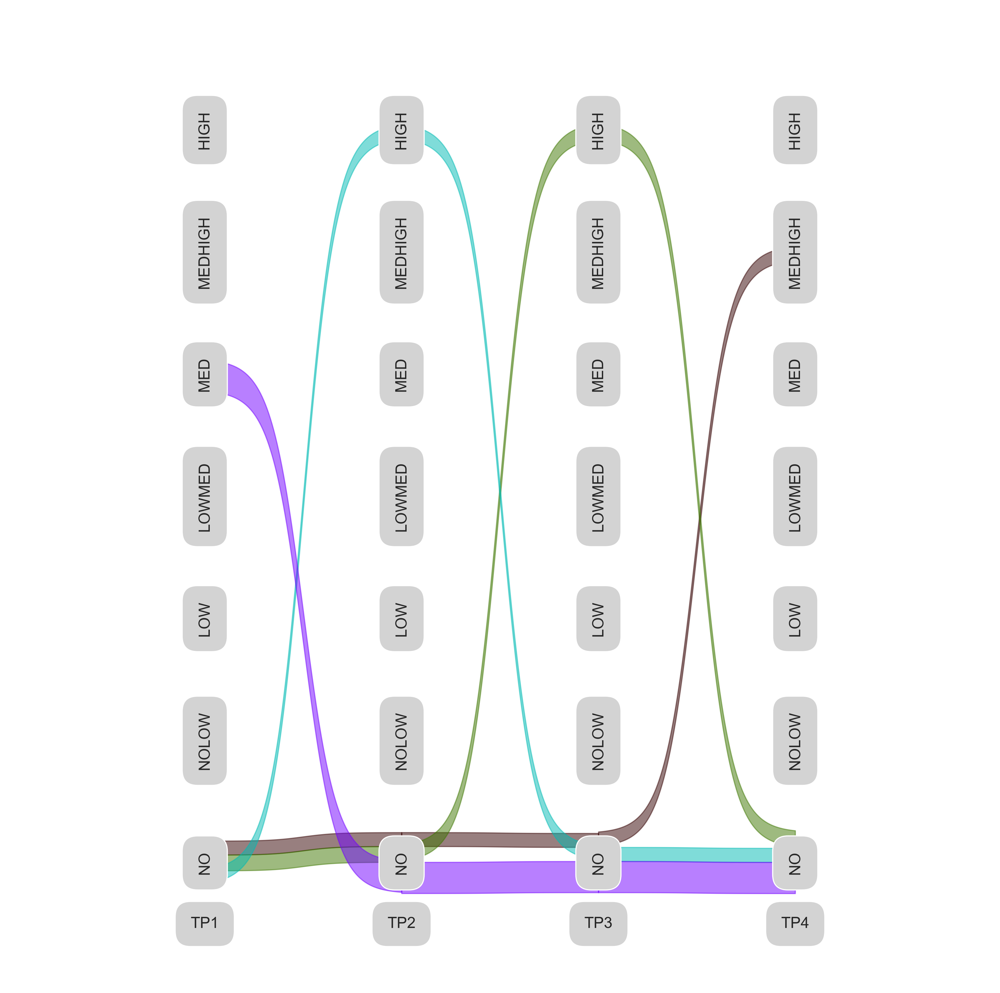

In [13]:
fa.plot_flows(use_flows=[1372,42,294,5])

Figure Size (16, 16)


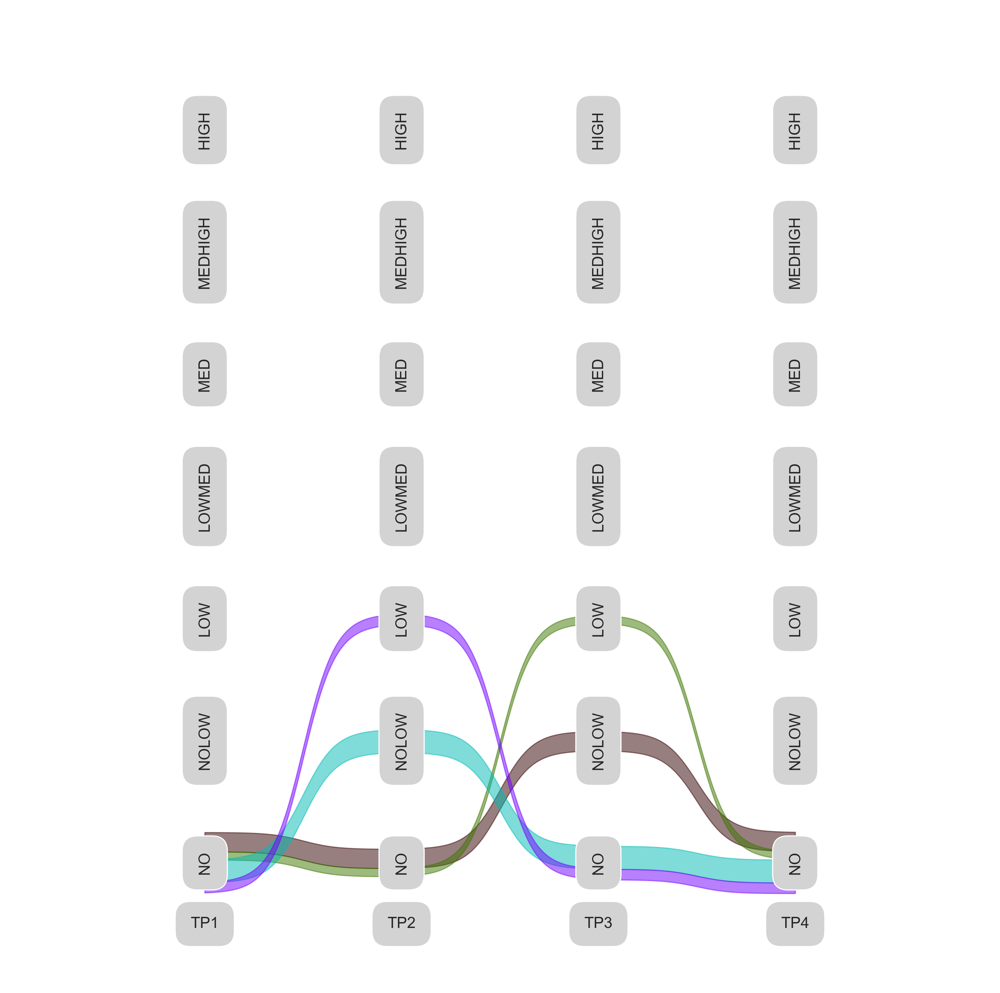

In [34]:
fa.plot_genes_membership(rp["R-HSA-804914"][1])

#fa.plot_flows(use_flows=[343,49,392,735,686,441,784,98,1127])
fa.plot_flows(use_flows=[49,7,14,98])

Figure Size (16, 16)


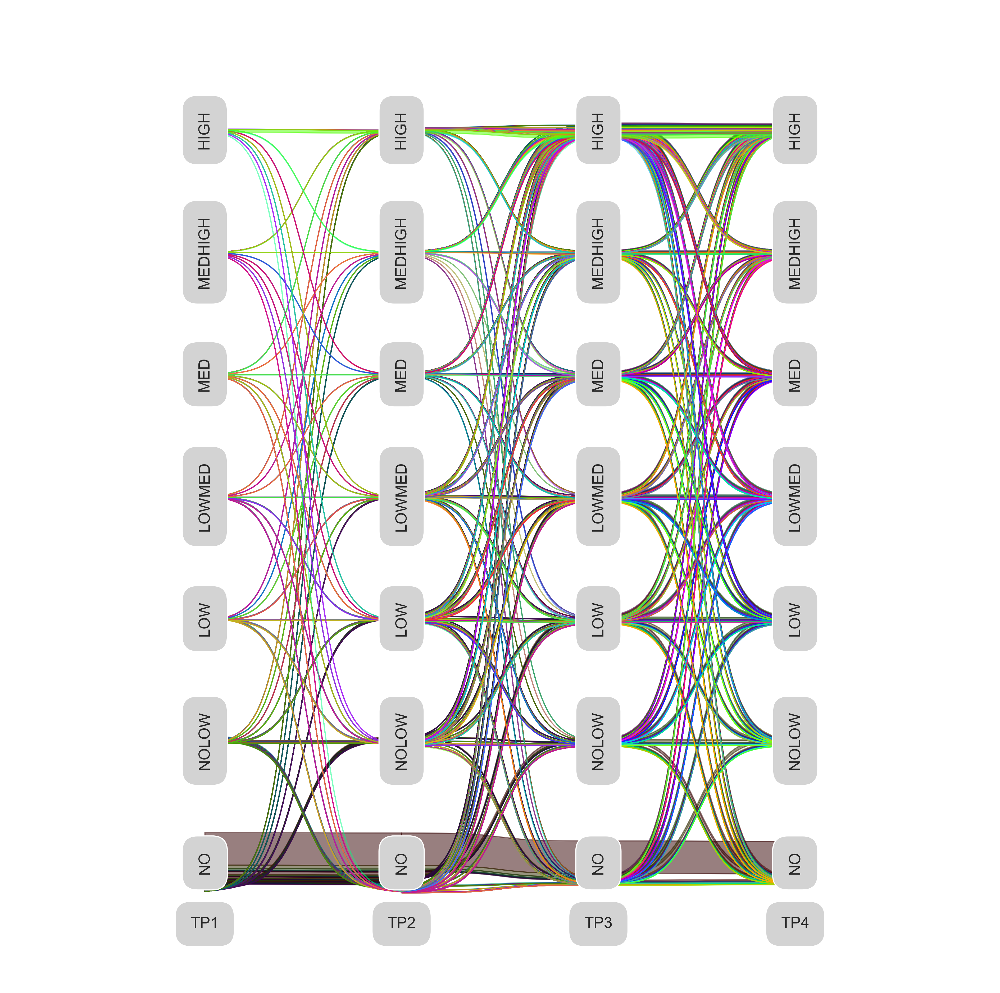

8 [('timepoint01', 'NO'), ('timepoint02', 'NO'), ('timepoint03', 'NOLOW'), ('timepoint04', 'NOLOW')]
16 [('timepoint01', 'NO'), ('timepoint02', 'NO'), ('timepoint03', 'LOW'), ('timepoint04', 'LOW')]
24 [('timepoint01', 'NO'), ('timepoint02', 'NO'), ('timepoint03', 'LOWMED'), ('timepoint04', 'LOWMED')]
32 [('timepoint01', 'NO'), ('timepoint02', 'NO'), ('timepoint03', 'MED'), ('timepoint04', 'MED')]
40 [('timepoint01', 'NO'), ('timepoint02', 'NO'), ('timepoint03', 'MEDHIGH'), ('timepoint04', 'MEDHIGH')]
48 [('timepoint01', 'NO'), ('timepoint02', 'NO'), ('timepoint03', 'HIGH'), ('timepoint04', 'HIGH')]
408 [('timepoint01', 'NOLOW'), ('timepoint02', 'NOLOW'), ('timepoint03', 'LOW'), ('timepoint04', 'LOW')]
416 [('timepoint01', 'NOLOW'), ('timepoint02', 'NOLOW'), ('timepoint03', 'LOWMED'), ('timepoint04', 'LOWMED')]
424 [('timepoint01', 'NOLOW'), ('timepoint02', 'NOLOW'), ('timepoint03', 'MED'), ('timepoint04', 'MED')]
432 [('timepoint01', 'NOLOW'), ('timepoint02', 'NOLOW'), ('timepoint03',

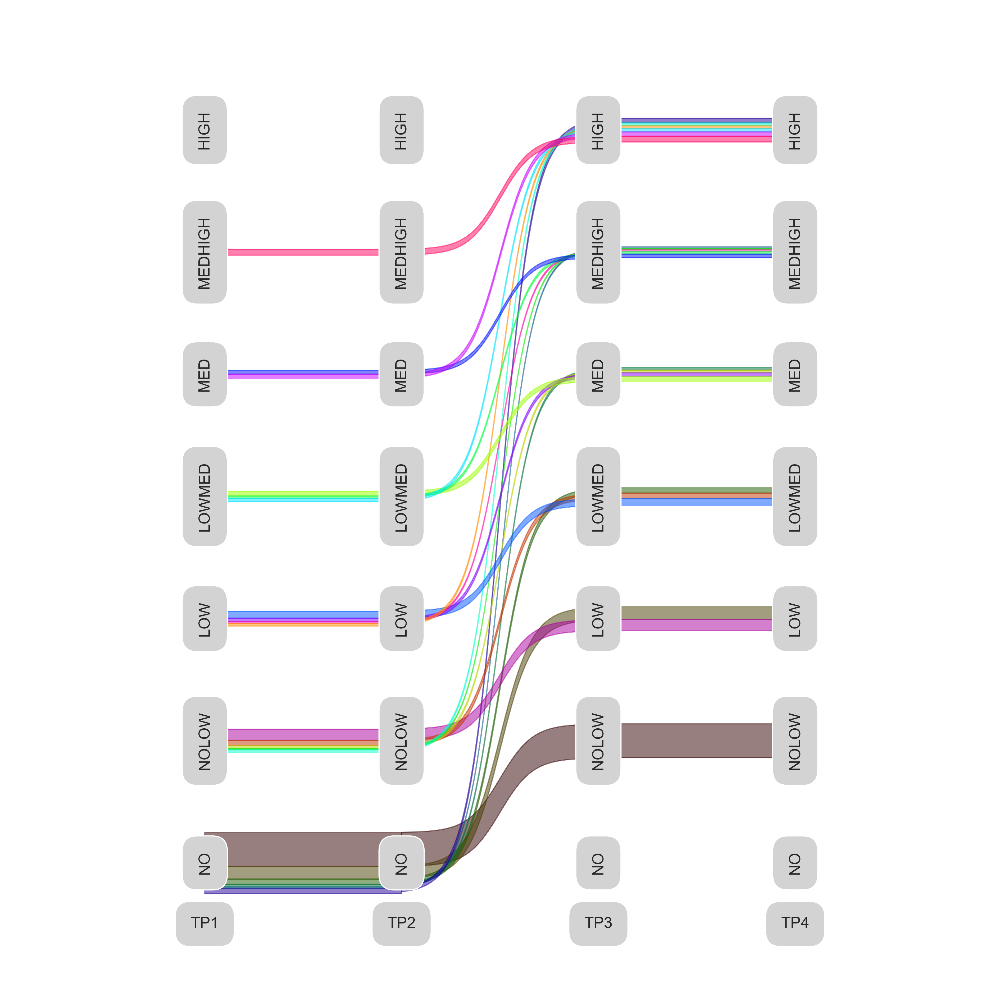

Loading pathways from ReactomePathways.gmt
Identified 2584 pathways
Calculating p-values for groups [2, 10, 50, 100, 2570]
Found: 4 in  53 significant


,pwid,pwname,pwFlow,pwGenes,allPwFlow,allPwGenes,pw_gene_intersection,pw_coverage,genes_coverage,mean_coverage,pw_coverage_zscore,pval,adj_pval
596,R-HSA-5619087,Defective SLC12A3 causes Gitelman syndrome (GS),0.000000,1,69.700098,8588.000019,1,0.000000,0.000000,0.000000,-0.661948,1.000000e+00,1.000000e+00
728,R-HSA-9675126,Diseases of mitotic cell cycle,1.457702,38,69.700098,8588.000019,37,0.038361,0.020914,0.000802,2.117010,1.712951e-02,5.602867e-01
929,R-HSA-8964315,G beta:gamma signalling through BTK,2.023819,18,69.700098,8588.000019,14,0.112434,0.029036,0.003265,7.535152,2.438827e-14,3.150965e-11
1016,R-HSA-389661,Glyoxylate metabolism and glycine degradation,1.021942,31,69.700098,8588.000019,25,0.032966,0.014662,0.000483,1.722414,4.249729e-02,1.000000e+00
1748,R-HSA-9013418,RHOBTB2 GTPase cycle,1.412250,23,69.700098,8588.000019,23,0.061402,0.020262,0.001244,3.802392,7.165292e-05,4.305841e-03
1825,R-HSA-442982,Ras activation upon Ca2+ influx through NMDA r...,0.115399,20,69.700098,8588.000019,17,0.005770,0.001656,0.000010,-0.266839,1.000000e+00,1.000000e+00
2346,R-HSA-456926,Thrombin signalling through proteinase activat...,2.371791,32,69.700098,8588.000019,27,0.074118,0.034029,0.002522,4.732529,1.108700e-06,1.685224e-04
2373,R-HSA-416993,Trafficking of GluR2-containing AMPA receptors,0.341695,17,69.700098,8588.000019,16,0.020100,0.004902,0.000099,0.781316,2.173084e-01,1.000000e+00
329,R-HSA-390466,Chaperonin-mediated protein folding,5.091655,92,69.700098,8588.000019,85,0.055344,0.073051,0.004043,6.501116,3.986316e-11,1.716773e-08
1445,R-HSA-193648,NRAGE signals death through JNK,1.574627,59,69.700098,8588.000019,57,0.026689,0.022591,0.000603,2.558245,5.260097e-03,1.887791e-01


,pwid,pwname,pwFlow,pwGenes,allPwFlow,allPwGenes,pw_gene_intersection,pw_coverage,genes_coverage,mean_coverage,pw_coverage_zscore,pval,adj_pval
893,R-HSA-390450,Folding of actin by CCT/TriC,0.964008,10,69.700098,8588.000019,10,0.096401,0.013831,0.001333,9.615946,3.423837e-22,8.847196e-19
929,R-HSA-8964315,G beta:gamma signalling through BTK,2.023819,18,69.700098,8588.000019,14,0.112434,0.029036,0.003265,7.535152,2.438827e-14,3.150965e-11
1696,R-HSA-392851,Prostacyclin signalling through prostacyclin r...,2.033593,19,69.700098,8588.000019,15,0.107031,0.029176,0.003123,7.139936,4.668725e-13,3.237763e-10
930,R-HSA-8964616,G beta:gamma signalling through CDC42,2.137955,20,69.700098,8588.000019,17,0.106898,0.030674,0.003279,7.130176,5.012016e-13,3.237763e-10
932,R-HSA-418217,G beta:gamma signalling through PLC beta,2.024183,20,69.700098,8588.000019,17,0.101209,0.029041,0.002939,6.714083,9.462659e-12,4.890302e-09
329,R-HSA-390466,Chaperonin-mediated protein folding,5.091655,92,69.700098,8588.000019,85,0.055344,0.073051,0.004043,6.501116,3.986316e-11,1.716773e-08
1678,R-HSA-500657,Presynaptic function of Kainate receptors,2.024183,21,69.700098,8588.000019,18,0.096390,0.029041,0.002799,6.361560,9.985720e-11,3.686157e-08
1698,R-HSA-391251,Protein folding,5.212982,98,69.700098,8588.000019,91,0.053194,0.074792,0.003978,6.205232,2.730811e-10,8.820519e-08
2347,R-HSA-428930,Thromboxane signalling through TP receptor,2.248406,24,69.700098,8588.000019,20,0.093684,0.032258,0.003022,6.163622,3.554984e-10,1.020676e-07
9,R-HSA-392170,ADP signalling through P2Y purinoceptor 12,2.055085,22,69.700098,8588.000019,17,0.093413,0.029485,0.002754,6.143826,4.027843e-10,1.040795e-07


In [35]:
# Analyse simulated UP pattern

up_geneset=[]
up_pathways=[]
key=list(pattern_groups.keys())[0]
value=pattern_groups[key]
union_geneset=[rp[list(rp.keys())[pwnames.index(p)]][1] for p in value]
up_pathways=[list(rp.keys())[pwnames.index(p)] for p in value]
up_geneset = [item for sublist in union_geneset for item in sublist]

fa.plot_genes(genes=up_geneset)

relFlows = set.union(
    fa.flow_finder(["=", "<", "="], maxLevels=[None,None,None,None], verbose=True)
)

fa.plot_flows(use_flows=relFlows)


pwScores = fa.analyse_pathways_grouped(use_flows=relFlows)
pwScores_signif=pwScores[pwScores["adj_pval"]<0.05]
print("Found: "+ str(pwScores_signif[pwScores_signif["pwid"].isin(up_pathways)].shape[0])+" in  "+ str(pwScores_signif.shape[0]) +" significant")
display(pwScores[pwScores["pwid"].isin(up_pathways)])
display(pwScores.sort_values("adj_pval").head(20))

Figure Size (16, 16)


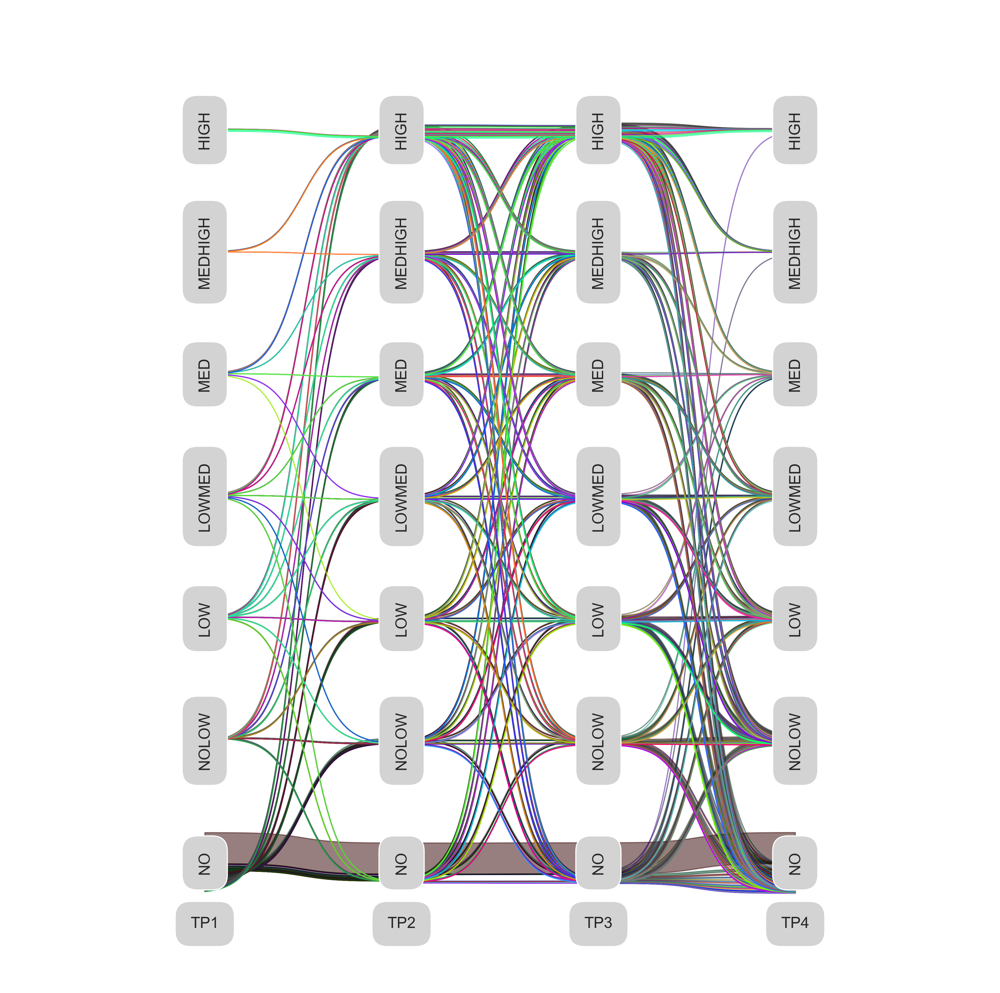

56 [('timepoint01', 'NO'), ('timepoint02', 'NOLOW'), ('timepoint03', 'NOLOW'), ('timepoint04', 'NO')]
112 [('timepoint01', 'NO'), ('timepoint02', 'LOW'), ('timepoint03', 'LOW'), ('timepoint04', 'NO')]
113 [('timepoint01', 'NO'), ('timepoint02', 'LOW'), ('timepoint03', 'LOW'), ('timepoint04', 'NOLOW')]
168 [('timepoint01', 'NO'), ('timepoint02', 'LOWMED'), ('timepoint03', 'LOWMED'), ('timepoint04', 'NO')]
169 [('timepoint01', 'NO'), ('timepoint02', 'LOWMED'), ('timepoint03', 'LOWMED'), ('timepoint04', 'NOLOW')]
170 [('timepoint01', 'NO'), ('timepoint02', 'LOWMED'), ('timepoint03', 'LOWMED'), ('timepoint04', 'LOW')]
224 [('timepoint01', 'NO'), ('timepoint02', 'MED'), ('timepoint03', 'MED'), ('timepoint04', 'NO')]
225 [('timepoint01', 'NO'), ('timepoint02', 'MED'), ('timepoint03', 'MED'), ('timepoint04', 'NOLOW')]
226 [('timepoint01', 'NO'), ('timepoint02', 'MED'), ('timepoint03', 'MED'), ('timepoint04', 'LOW')]
227 [('timepoint01', 'NO'), ('timepoint02', 'MED'), ('timepoint03', 'MED'), (

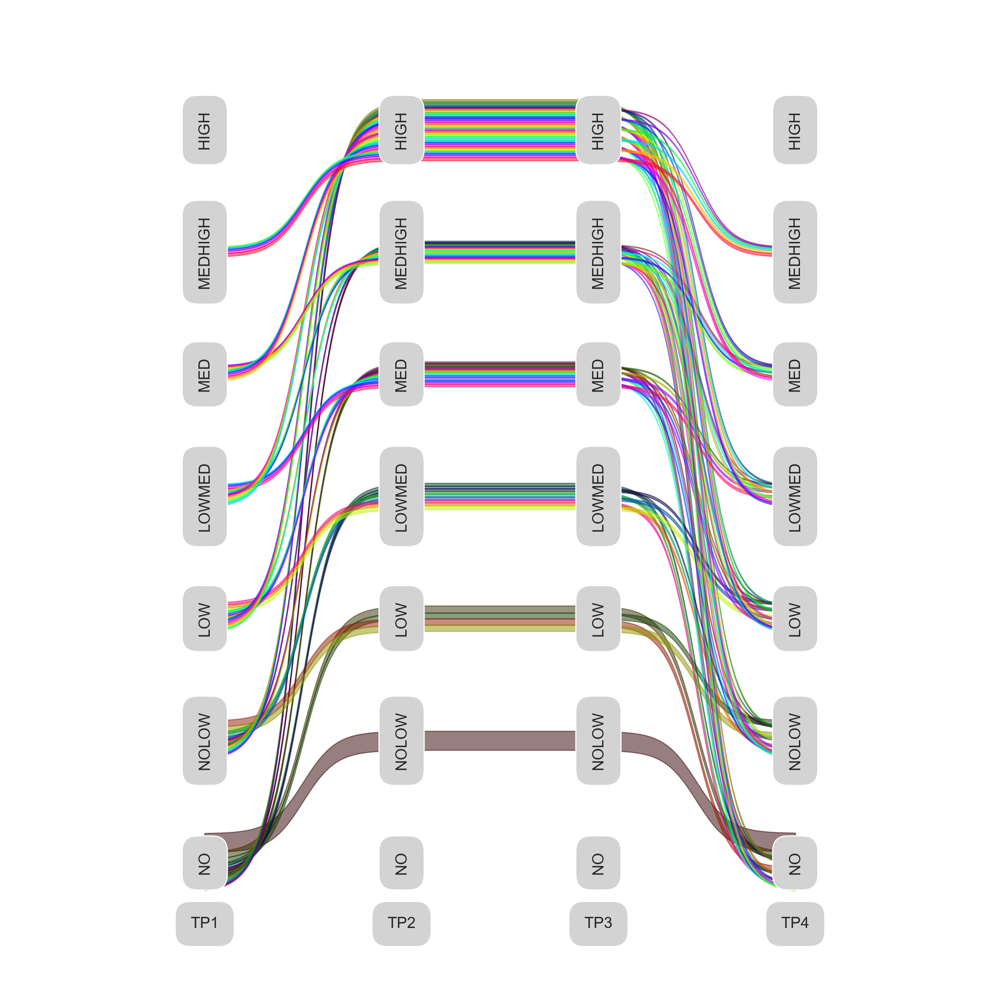

Loading pathways from ReactomePathways.gmt
Identified 2584 pathways
Calculating p-values for groups [2, 10, 50, 100, 2570]
Found: 4 in  53 significant


,pwid,pwname,pwFlow,pwGenes,allPwFlow,allPwGenes,pw_gene_intersection,pw_coverage,genes_coverage,mean_coverage,pw_coverage_zscore,pval,adj_pval
1300,R-HSA-2206292,MPS VII - Sly syndrome,0.116414,1,102.727261,8588.000019,1,0.116414,0.001133,0.000132,2.271294,1.156458e-02,3.248138e-01
1798,R-HSA-444257,RSK activation,1.587462,7,102.727261,8588.000019,7,0.226780,0.015453,0.003504,3.023522,1.249253e-03,5.764413e-02
2158,R-HSA-3304351,Signaling by TGF-beta Receptor Complex in Cancer,1.404963,8,102.727261,8588.000019,8,0.175620,0.013677,0.002402,2.259133,1.193757e-02,3.260858e-01
2429,R-HSA-804914,Transport of fatty acids,0.034803,8,102.727261,8588.000019,4,0.004350,0.000339,0.000001,-0.299845,1.000000e+00,1.000000e+00
269,R-HSA-442742,CREB1 phosphorylation through NMDA receptor-me...,4.673278,28,102.727261,8588.000019,25,0.166903,0.045492,0.007593,4.315216,7.972348e-06,7.357338e-04
678,R-HSA-3296469,Defects in cobalamin (B12) metabolism,1.582418,14,102.727261,8588.000019,11,0.113030,0.015404,0.001741,2.689823,3.574493e-03,1.338622e-01
877,R-HSA-5654693,FRS-mediated FGFR1 signaling,2.970410,23,102.727261,8588.000019,16,0.129148,0.028916,0.003734,3.176130,7.462698e-04,3.935431e-02
2377,R-HSA-1362300,Transcription of E2F targets under negative co...,2.303688,16,102.727261,8588.000019,16,0.143981,0.022425,0.003229,3.623632,1.452473e-04,9.382978e-03
36,R-HSA-8854518,AURKA Activation by TPX2,12.650065,72,102.727261,8588.000019,70,0.175695,0.123142,0.021636,5.923137,1.579288e-09,5.829830e-07
1532,R-HSA-381753,Olfactory Signaling Pathway,0.555448,422,102.727261,8588.000019,53,0.001316,0.005407,0.000007,-1.208233,1.000000e+00,1.000000e+00


,pwid,pwname,pwFlow,pwGenes,allPwFlow,allPwGenes,pw_gene_intersection,pw_coverage,genes_coverage,mean_coverage,pw_coverage_zscore,pval,adj_pval
2093,R-HSA-1839120,Signaling by FGFR1 amplification mutants,0.432992,1,102.727261,8588.000019,1,0.432992,0.004215,0.001825,9.492798,1.124575e-21,2.905901e-18
1727,R-HSA-9649913,RAS GTPase cycle mutants,1.910335,3,102.727261,8588.000019,3,0.636778,0.018596,0.011842,9.149377,2.863133e-20,1.849584e-17
2147,R-HSA-9753512,Signaling by RAS GTPase mutants,1.910335,3,102.727261,8588.000019,3,0.636778,0.018596,0.011842,9.149377,2.863133e-20,1.849584e-17
2146,R-HSA-9753510,Signaling by RAS GAP mutants,1.910335,3,102.727261,8588.000019,3,0.636778,0.018596,0.011842,9.149377,2.863133e-20,1.849584e-17
561,R-HSA-3359473,Defective MMADHC causes MMAHCD,0.786014,2,102.727261,8588.000019,2,0.393007,0.007651,0.003007,8.580692,4.715223e-18,2.436827e-15
821,R-HSA-9634635,Estrogen-stimulated signaling through PRKCZ,2.621621,6,102.727261,8588.000019,6,0.436937,0.025520,0.011151,6.163508,3.557532e-10,1.532110e-07
36,R-HSA-8854518,AURKA Activation by TPX2,12.650065,72,102.727261,8588.000019,70,0.175695,0.123142,0.021636,5.923137,1.579288e-09,5.829830e-07
1254,R-HSA-380259,Loss of Nlp from mitotic centrosomes,11.933556,69,102.727261,8588.000019,67,0.172950,0.116167,0.020091,5.819307,2.954613e-09,8.483023e-07
1258,R-HSA-380284,Loss of proteins required for interphase micro...,11.933556,69,102.727261,8588.000019,67,0.172950,0.116167,0.020091,5.819307,2.954613e-09,8.483023e-07
2559,R-HSA-111995,phospho-PLA2 pathway,0.537483,2,102.727261,8588.000019,2,0.268742,0.005232,0.001406,5.746064,4.567246e-09,1.180176e-06


In [36]:
# Analyse simulated tempUP pattern

tup_geneset=[]
tup_pathways=[]
key=list(pattern_groups.keys())[1]
value=pattern_groups[key]
union_geneset=[rp[list(rp.keys())[pwnames.index(p)]][1] for p in value]
tup_pathways=[list(rp.keys())[pwnames.index(p)] for p in value]
tup_geneset = [item for sublist in union_geneset for item in sublist]
fa.plot_genes(genes=tup_geneset)

relFlows = set.union(
    fa.flow_finder(["<", "=", ">"], maxLevels=[None,None,None,None], verbose=True)
)

fa.plot_flows(use_flows=relFlows)


pwScores = fa.analyse_pathways_grouped(use_flows=relFlows)
pwScores_signif=pwScores[pwScores["adj_pval"]<0.05]
print("Found: "+ str(pwScores_signif[pwScores_signif["pwid"].isin(tup_pathways)].shape[0])+" in  "+ str(pwScores_signif.shape[0]) +" significant")

display(pwScores[pwScores["pwid"].isin(tup_pathways)])
display(pwScores.sort_values("adj_pval").head(20))

Figure Size (16, 16)


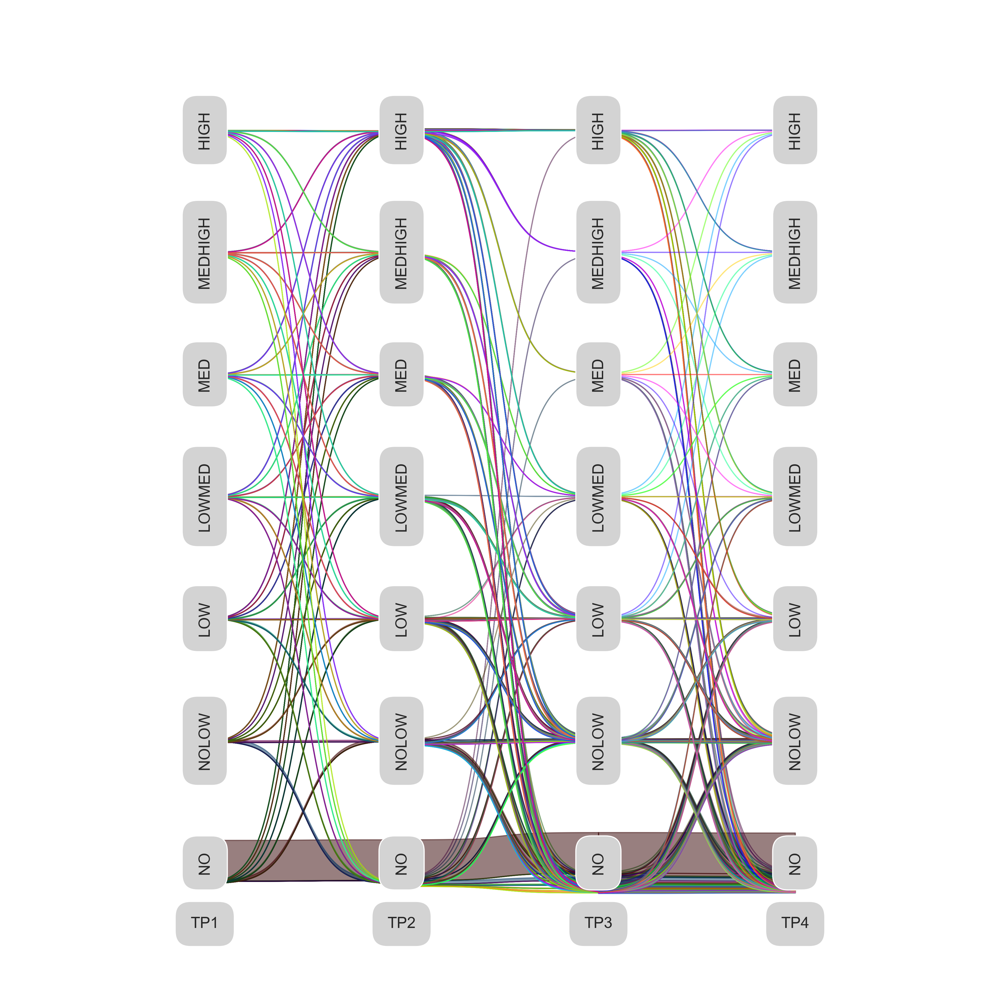

49 [('timepoint01', 'NO'), ('timepoint02', 'NOLOW'), ('timepoint03', 'NO'), ('timepoint04', 'NO')]
50 [('timepoint01', 'NO'), ('timepoint02', 'NOLOW'), ('timepoint03', 'NO'), ('timepoint04', 'NOLOW')]
392 [('timepoint01', 'NOLOW'), ('timepoint02', 'NOLOW'), ('timepoint03', 'NO'), ('timepoint04', 'NO')]
393 [('timepoint01', 'NOLOW'), ('timepoint02', 'NOLOW'), ('timepoint03', 'NO'), ('timepoint04', 'NOLOW')]
441 [('timepoint01', 'NOLOW'), ('timepoint02', 'LOW'), ('timepoint03', 'NO'), ('timepoint04', 'NO')]
442 [('timepoint01', 'NOLOW'), ('timepoint02', 'LOW'), ('timepoint03', 'NO'), ('timepoint04', 'NOLOW')]
448 [('timepoint01', 'NOLOW'), ('timepoint02', 'LOW'), ('timepoint03', 'NOLOW'), ('timepoint04', 'NO')]
449 [('timepoint01', 'NOLOW'), ('timepoint02', 'LOW'), ('timepoint03', 'NOLOW'), ('timepoint04', 'NOLOW')]
450 [('timepoint01', 'NOLOW'), ('timepoint02', 'LOW'), ('timepoint03', 'NOLOW'), ('timepoint04', 'LOW')]
735 [('timepoint01', 'LOW'), ('timepoint02', 'NOLOW'), ('timepoint03'

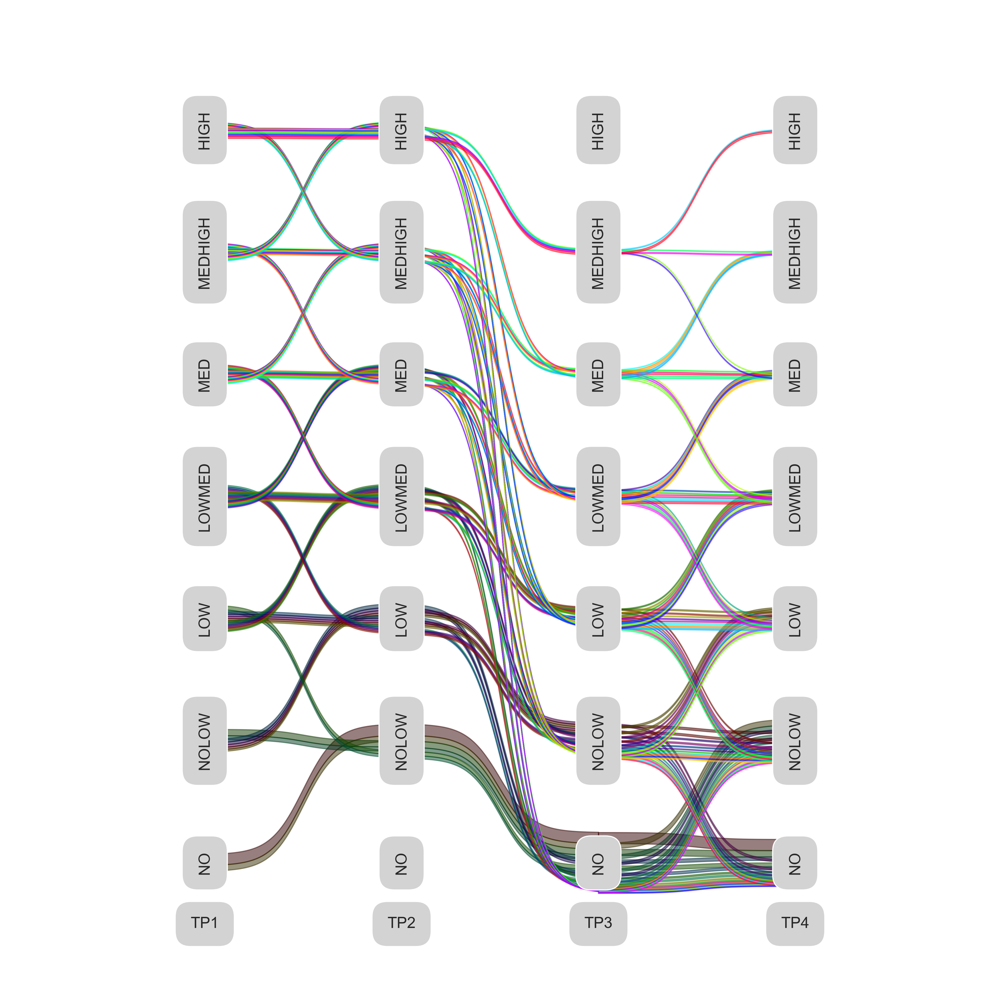

Loading pathways from ReactomePathways.gmt
Identified 2584 pathways
Calculating p-values for groups [2, 10, 50, 100, 2570]
Found: 1 in  23 significant


,pwid,pwname,pwFlow,pwGenes,allPwFlow,allPwGenes,pw_gene_intersection,pw_coverage,genes_coverage,mean_coverage,pw_coverage_zscore,pval,adj_pval
470,R-HSA-4793953,Defective B4GALT1 causes CDG-2d,0.407870,1,675.347645,8588.000019,1,0.407870,0.000604,2.463291e-04,4.168280,0.000015,0.003304
484,R-HSA-3656225,Defective CHST6 causes MCDC1,0.914371,8,675.347645,8588.000019,5,0.114296,0.001354,1.547490e-04,0.868998,0.192424,1.000000
553,R-HSA-5083630,Defective LFNG causes SCDO3,0.131425,5,675.347645,8588.000019,5,0.026285,0.000195,5.115122e-06,-0.528782,1.000000,1.000000
1973,R-HSA-9692913,SARS-CoV-1-mediated effects on programmed cell...,0.027593,4,675.347645,8588.000019,1,0.006898,0.000041,2.818405e-07,-0.836678,1.000000,1.000000
974,R-HSA-157858,Gap junction trafficking and regulation,2.544301,31,675.347645,8588.000019,21,0.082074,0.003767,3.092059e-04,0.071286,0.471585,1.000000
1128,R-HSA-8875360,InlB-mediated entry of Listeria monocytogenes ...,4.193204,16,675.347645,8588.000019,15,0.262075,0.006209,1.627214e-03,3.136812,0.000854,0.088267
1210,R-HSA-2022857,Keratan sulfate degradation,1.526062,12,675.347645,8588.000019,9,0.127172,0.002260,2.873662e-04,0.839326,0.200643,1.000000
1614,R-HSA-390918,Peroxisomal lipid metabolism,3.311833,29,675.347645,8588.000019,29,0.114201,0.004904,5.600301e-04,0.618427,0.268147,1.000000
1947,R-HSA-975634,Retinoid metabolism and transport,3.564044,44,675.347645,8588.000019,35,0.081001,0.005277,4.274703e-04,0.053009,0.478862,1.000000
2176,R-HSA-983705,Signaling by the B Cell Receptor (BCR),27.656564,175,675.347645,8588.000019,102,0.158038,0.040952,6.471888e-03,0.981821,0.163094,1.000000


,pwid,pwname,pwFlow,pwGenes,allPwFlow,allPwGenes,pw_gene_intersection,pw_coverage,genes_coverage,mean_coverage,pw_coverage_zscore,pval,adj_pval
1311,R-HSA-9683683,Maturation of protein E_9683683,2.541030,5,675.347645,8588.000019,4,0.508206,0.003763,0.001912,7.124985,5.204597e-13,6.724339e-10
1312,R-HSA-9694493,Maturation of protein E_9694493,2.541030,5,675.347645,8588.000019,4,0.508206,0.003763,0.001912,7.124985,5.204597e-13,6.724339e-10
1886,R-HSA-211733,Regulation of activated PAK-2p34 by proteasome...,21.454345,50,675.347645,8588.000019,48,0.429087,0.031768,0.013631,5.981121,1.108033e-09,9.543854e-07
869,R-HSA-9706377,FLT3 signaling by CBL mutants,2.907373,7,675.347645,8588.000019,7,0.415339,0.004305,0.001788,5.650091,8.018144e-09,5.179721e-06
392,R-HSA-1236978,Cross-presentation of soluble exogenous antige...,18.712270,50,675.347645,8588.000019,45,0.374245,0.027708,0.010369,5.047138,2.242389e-07,1.158867e-04
651,R-HSA-5660883,Defective SLC7A9 causes cystinuria (CSNU),0.931919,2,675.347645,8588.000019,1,0.465959,0.001380,0.000643,4.887037,5.118241e-07,1.889362e-04
632,R-HSA-5619113,Defective SLC3A1 causes cystinuria (CSNU),0.931919,2,675.347645,8588.000019,1,0.465959,0.001380,0.000643,4.887037,5.118241e-07,1.889362e-04
1868,R-HSA-8948747,Regulation of PTEN localization,3.192737,9,675.347645,8588.000019,9,0.354749,0.004728,0.001677,4.687807,1.380743e-06,4.459800e-04
1598,R-HSA-8849469,PTK6 Regulates RTKs and Their Effectors AKT1 a...,2.980712,9,675.347645,8588.000019,9,0.331190,0.004414,0.001462,4.313659,8.028724e-06,2.298733e-03
745,R-HSA-1253288,Downregulation of ERBB4 signaling,2.960561,9,675.347645,8588.000019,9,0.328951,0.004384,0.001442,4.278100,9.424749e-06,2.298733e-03


In [19]:
# Analyse simulated DOWN pattern

down_geneset=[]
down_pathways=[]
key=list(pattern_groups.keys())[2]
value=pattern_groups[key]
union_geneset=[rp[list(rp.keys())[pwnames.index(p)]][1] for p in value]
down_pathways=[list(rp.keys())[pwnames.index(p)] for p in value]
down_geneset = [item for sublist in union_geneset for item in sublist]

fa.plot_genes(genes=down_geneset)

relFlows = set.union(
    fa.flow_finder(["~", ">", "~"], maxLevels=[None,None,None,None], verbose=True)
)

fa.plot_flows(use_flows=relFlows)


pwScores = fa.analyse_pathways_grouped(use_flows=relFlows)
pwScores_signif=pwScores[pwScores["adj_pval"]<0.05]
print("Found: "+ str(pwScores_signif[pwScores_signif["pwid"].isin(down_pathways)].shape[0])+" in  "+ str(pwScores_signif.shape[0]) +" significant")
display(pwScores[pwScores["pwid"].isin(down_pathways)])
display(pwScores.sort_values("adj_pval").head(20))
